# Análise de Vendas e Insights: Brazilian E-commerce Public Dataset by Olist

## 1. Preparação dos Dados 

## Importando as bibliotecas necessárias para a extração, tratamento, limpeza e visualização dos dados. 

In [3]:
# Bibliotecas necessárias. 
import os 
import json
import requests
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import sqlite3
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from geopy.distance import geodesic

In [4]:
# Criando uma pasta de dados limpos
os.makedirs('dados_tratados', exist_ok=True)

In [5]:
# Funções auxiliares
def padronizar_colunas(df):
    """
    Deixa os nomes das colunas em minúsculo, sem espaços e com underline.
    """
    df.columns = df.columns.str.strip().str.lower().str.replace(' ', '_')
    return df

def converter_datetime(df, colunas):
    """
    Converte colunas para o formato datetime.
    """
    for col in colunas:
        df[col] = pd.to_datetime(df[col], errors='coerce')
    return df

def remover_duplicatas(df):
    """
    Remove duplicatas e informa quantas foram excluídas.
    """
    qnt_anterior = df.shape[0]
    df = df.drop_duplicates()
    qnt_deletada = qnt_anterior - df.shape[0]
    print(f'Duplicatas removidas: {qnt_deletada}')
    return df

def remover_produtos_sem_categoria(df):
    """
    Remove produtos sem categoria e mostra o total removido.
    """
    qnt_anterior = df.shape[0]
    df = df.dropna(subset=['product_category_name'])
    qnt_deletada = qnt_anterior - df.shape[0]
    print(f'Produtos sem categoria removidos: {qnt_deletada}')
    return df

def adicionar_traducao_categorias(products_df, translation_df):
    """
    Adiciona a tradução dos nomes das categorias.
    """
    return products_df.merge(translation_df, on='product_category_name', how='left')

def verificar_nulos(nome_df, df):
    """
    Mostra os valores nulos por coluna.
    """
    print(f'{nome_df.upper()} - Valores nulos:')
    print(df.isnull().sum())
    print()

In [6]:
# Importando e padronizando o dataset Brazilian E-commerce, utilizando a biblioteca Pandas.
print("Carregando datasets...")
orders = padronizar_colunas(pd.read_csv('olist_orders_dataset.csv'))
customers = padronizar_colunas(pd.read_csv('olist_customers_dataset.csv'))
geolocation = padronizar_colunas(pd.read_csv('olist_geolocation_dataset.csv'))
order_items = padronizar_colunas(pd.read_csv('olist_order_items_dataset.csv'))
order_payments = padronizar_colunas(pd.read_csv('olist_order_payments_dataset.csv'))
order_reviews = padronizar_colunas(pd.read_csv('olist_order_reviews_dataset.csv'))
products = padronizar_colunas(pd.read_csv('olist_products_dataset.csv'))
sellers = padronizar_colunas(pd.read_csv('olist_sellers_dataset.csv'))
product_category_name_translation = padronizar_colunas(pd.read_csv('product_category_name_translation.csv'))

Carregando datasets...


In [7]:
# Converte colunas de data para datetime
orders = converter_datetime(orders, [
    'order_purchase_timestamp',
    'order_approved_at',
    'order_delivered_carrier_date',
    'order_delivered_customer_date',
    'order_estimated_delivery_date'
])

# Cria uma coluna com o mês da compra
orders['order_month'] = orders['order_purchase_timestamp'].dt.to_period('M')

# Remove duplicatas em todos os dataframes principais
dfs = [orders, customers, geolocation, order_items, order_payments, order_reviews, products, sellers]
nomes = ['orders', 'customers', 'geolocation', 'order_items', 'order_payments', 'order_reviews', 'products', 'sellers']

for df, nome in zip(dfs, nomes):
    duplicatas = df.duplicated().sum()
    print(f'{nome} - Duplicatas removidas: {duplicatas}')
    df.drop_duplicates(inplace=True)

# Verifica nulos nas colunas do dataframe de pedidos
print('Nulos antes do tratamento:')
print(orders.isnull().sum())

# Converte coluna de período para string (recomendado para exportações SQL)
orders['order_month'] = orders['order_month'].astype(str)

orders - Duplicatas removidas: 0
customers - Duplicatas removidas: 0
geolocation - Duplicatas removidas: 261831
order_items - Duplicatas removidas: 0
order_payments - Duplicatas removidas: 0
order_reviews - Duplicatas removidas: 0
products - Duplicatas removidas: 0
sellers - Duplicatas removidas: 0
Nulos antes do tratamento:
order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
order_month                         0
dtype: int64


In [8]:
# Salva todos os dataframes tratados como arquivos CSV
orders.to_csv('dados_tratados/orders_clean.csv', index=False)
customers.to_csv('dados_tratados/customers_clean.csv', index=False)
order_items.to_csv('dados_tratados/order_items_clean.csv', index=False)
products.to_csv('dados_tratados/products_clean.csv', index=False)
sellers.to_csv('dados_tratados/sellers_clean.csv', index=False)
order_payments.to_csv('dados_tratados/order_payments_clean.csv', index=False)
order_reviews.to_csv('dados_tratados/order_reviews_clean.csv', index=False)
geolocation.to_csv('dados_tratados/geolocation_clean.csv', index=False)

print('Arquivos salvos com sucesso! ✅')


Arquivos salvos com sucesso! ✅


## Limpeza dos dados e tratamento de valores nulos/duplicados
Após análise, foram identificados:
- **Orders:** Presença de valores nulos nas colunas `order_approved_at`, `order_delivered_carrier_date`, `order_delivered_customer_date`.  
Estes campos nulos indicam pedidos que não seguiram o fluxo completo (cancelados, em processamento e outros), porém, vamos manter esses valores pois fazem parte do processo.  

## Nenhum dataset apresentou duplicatas 

## Próxima etapa:
    - Ajustar o padrão de nomes das colunas 
    - Garantir que datas sejam interpretadas como datetime.


In [9]:
# Converter colunas de data no DataFrame 'orders' para datetime
colunas_data = [
    'order_purchase_timestamp',
    'order_approved_at',
    'order_delivered_carrier_date',
    'order_delivered_customer_date',
    'order_estimated_delivery_date'
]

orders[colunas_data] = orders[colunas_data].apply(pd.to_datetime)

## Criação do Modelo Relacional entre Tabelas

Para organizar melhor as análises e facilitar as conexões entre os dados, foi criado um modelo relacional utilizando SQLite em memória para simular como as tabelas do dataset se conectam, utilizando chaves comuns entre elas.

Essa estrutura permite realizar consultas relacionais (como JOINs), judando a responder perguntas com base em mais de uma tabela.

### Tabelas e Principais Chaves de Relacionamento:

- **orders** → `order_id` (chave primária da tabela de pedidos)
- **customers** → `customer_id` (ligada à orders via `customer_id`)
- **order_items** → `order_id`, `product_id`, `seller_id` (liga pedidos, produtos e vendedores)
- **products** → `product_id` (detalhes do produto vendido)
- **sellers** → `seller_id` (informações do vendedor)
- **order_payments** → `order_id` (pagamentos de cada pedido)
- **order_reviews** → `order_id` (avaliações relacionadas ao pedido)
- **product_category_name_translation** → `product_category_name` (tradução dos nomes das categorias)

In [ ]:
# Banco de dados relacional criado em memória
conn = sqlite3.connect(':memory:')
cursor = conn.cursor()

# Exportando os Dataframes prontos para tabelas SQL
customers.to_sql('customers', conn, index=False)
orders.to_sql('orders', conn, index=False)
order_items.to_sql('order_items', conn, index=False)
order_payments.to_sql('order_payments', conn, index=False)
order_reviews.to_sql('order_reviews', conn, index=False, if_exists='replace')
products.to_sql('products', conn, index=False)
sellers.to_sql('sellers', conn, index=False)

print('Banco de dados relacional criado com sucesso! ✅')

Banco de dados relacional criado com sucesso! ✅


## 2. Análise Exploratória de Dados

### a) Qual o volume de pedidos por mês? Existe sazonalidade nas vendas?

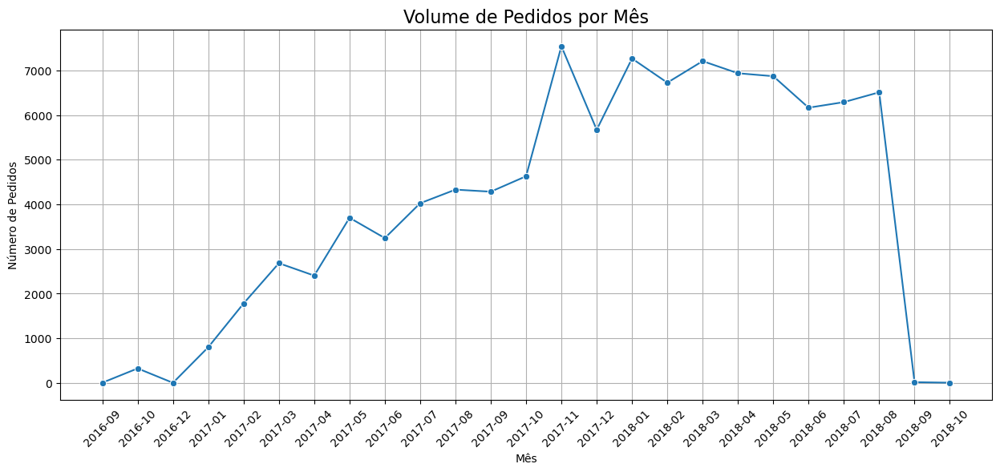

In [11]:
# Consulta SQL: volume de pedidos por mês
query = """
SELECT 
    strftime('%Y-%m', order_purchase_timestamp) AS order_purchase_month,
    COUNT(DISTINCT order_id) AS total_orders
FROM orders
GROUP BY order_purchase_month
ORDER BY order_purchase_month;
"""
orders_per_month = pd.read_sql_query(query, conn)

# Gráfico de Volume de Pedidos por Mês 
plt.figure(figsize=(15,6))
sns.lineplot(data=orders_per_month, x='order_purchase_month', y='total_orders', marker='o')
plt.title('Volume de Pedidos por Mês', fontsize=16)
plt.xlabel('Mês')
plt.ylabel('Número de Pedidos')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

#### Análise A: Insight

Analisando o volume de pedidos por mês, observamos a seguinte tendência:
Há um crescimento em novembro de 2017, mês que apresenta um pico possivelmente relacionado à Black Friday, exigindo planejamento prévio, seguido de estabilidade até agosto de 2018; a queda observada pós esse período foge do padrão sazonal e indica possível ruptura estrutural ou falha de coleta.

### b) Qual a distribuição do tempo de entrega dos pedidos?

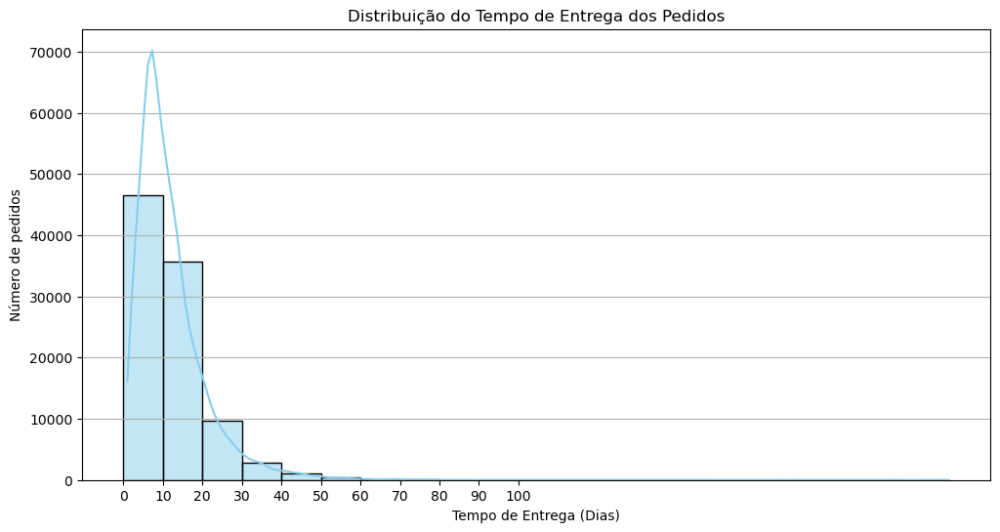

In [12]:
# Garante datas no formato datetime
orders['order_delivered_customer_date'] = pd.to_datetime(orders['order_delivered_customer_date'], errors='coerce')
orders['order_purchase_timestamp'] = pd.to_datetime(orders['order_purchase_timestamp'], errors='coerce')

# Trabalha com a cópia do dataframe para preservar o original
delivered_orders = orders.dropna(subset=['order_delivered_customer_date', 'order_purchase_timestamp']).copy()

# Calcula tempo de entrega em dias
delivered_orders['delivery_time_days'] = (
    delivered_orders['order_delivered_customer_date'] - delivered_orders['order_purchase_timestamp']
).dt.days

# Remove valores negativos ou nulos
delivery_time = delivered_orders[(delivered_orders['delivery_time_days'] > 0)]

# Gráfico 
plt.figure(figsize=(12,6))
sns.histplot(delivery_time['delivery_time_days'], bins=range(0, 101, 10), color='skyblue', edgecolor='black', kde=True)
plt.xticks(range(0, 101, 10))
plt.title('Distribuição do Tempo de Entrega dos Pedidos')
plt.xlabel('Tempo de Entrega (Dias)')
plt.ylabel('Número de pedidos')
plt.grid(True, axis='y')
plt.show()

#### Análise B: Insight

A maior parte dos pedidos é entregue em até 20 dias, com pico entre 10 e 20 dias. A visualização em intervalos de 10 em 10 dias destacou esse padrão com clareza. A distribuição é assimétrica à direita, com casos atípicos acima de 60 dias. Isso sugere uma operação logística eficiente na média, mas com exceções que devem ser investigadas para reduzir atrasos extremos e otimizar o serviço.


### c) Qual a relação entre o valor do frete e a distância de entrega?

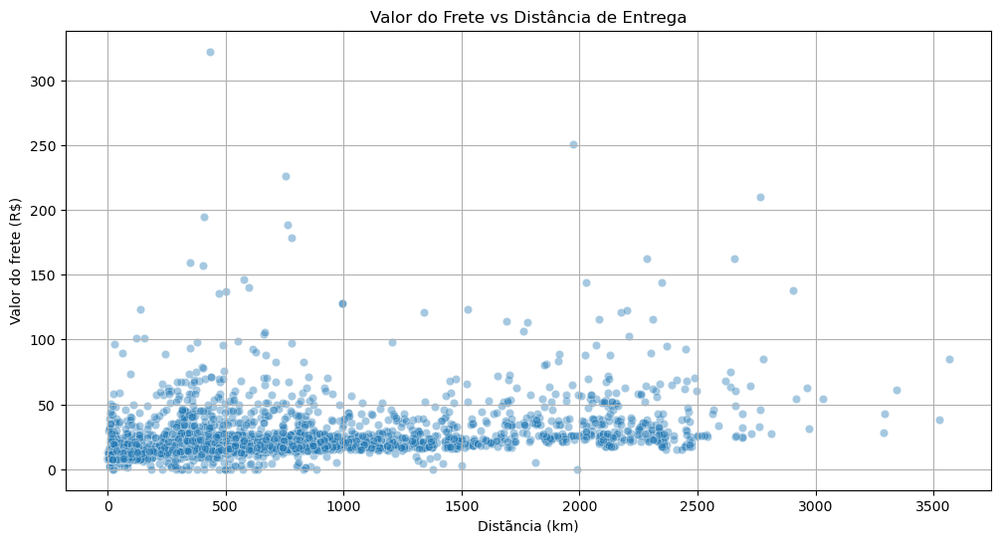

In [ ]:
# Seleciona colunas essencias de cada tabela
df = orders. copy()

# Junta o CEP dos clientes em orders
df = df.merge(customers[['customer_id', 'customer_zip_code_prefix']], on='customer_id', how='left')

# Junta o seller_id e freight_value em orders via order_items
df = df.merge(order_items[['order_id', 'seller_id', 'freight_value']], on='order_id', how='left')

# Junta o CEP dos vendedores
df = df.merge(sellers[['seller_id', 'seller_zip_code_prefix']], on='seller_id', how='left')

# Agrupa coordenadas médias por prefixo de CEP
geo_coords = geolocation.groupby('geolocation_zip_code_prefix')[['geolocation_lat', 'geolocation_lng']].mean()
geo_coords.columns = ['lat', 'lng']

# Junta coordenadas de clientes e vendedores
df = df.merge(geo_coords.rename(columns={'lat': 'lat_cust', 'lng': 'lng_cust'}),
            left_on='customer_zip_code_prefix', right_index=True, how='left')
df = df.merge(geo_coords.rename(columns={'lat': 'lat_sell', 'lng': 'lng_sell'}),
              left_on='seller_zip_code_prefix', right_index=True, how='left')

# Calcula a distância
def calc_distancia(row):
    try:
        coords_cust = (row['lat_cust'], row['lng_cust'])
        coords_sell = (row['lat_sell'], row['lng_sell'])
        if pd.isnull(coords_cust[0]) or pd.isnull(coords_cust[1]) or pd.isnull(coords_sell[0]) or pd.isnull(coords_sell[1]):
            return np.nan
        return geodesic(coords_cust, coords_sell).kilometers
    except:
        return np.nan
    
df['distance_km'] = df.apply(calc_distancia, axis=1)


# Plot: Relação entre distância e valor do frete 
plt.figure(figsize=(12, 6))
sns.scatterplot(data=df.sample(5000, random_state=42), x='distance_km', y='freight_value', alpha=0.4)
plt.title('Valor do Frete vs Distância de Entrega')
plt.xlabel('Distãncia (km)')
plt.ylabel('Valor do frete (R$)')
plt.grid(True)
plt.show()


#### Análise C: Insight

Observando a relação entre valor do frete e distância de entrega, notamos uma baixa correlação. Mesmo com entregas superiores a 3.000 km, a maioria dos fretes permanece abaixo de R$50. Além disso, há valores extremos que ultrapassam R$300, mas sem associação direta com maiores distâncias. Essa dispersão indica que a distância não é o principal fator de precificação, sugerindo influência de outros elementos, como peso do produto, tipo de transporte ou estratégias comerciais adotadas por cada vendedor.

### d) Quais são as categorias de produtos mais vendidas em termos de faturamento?

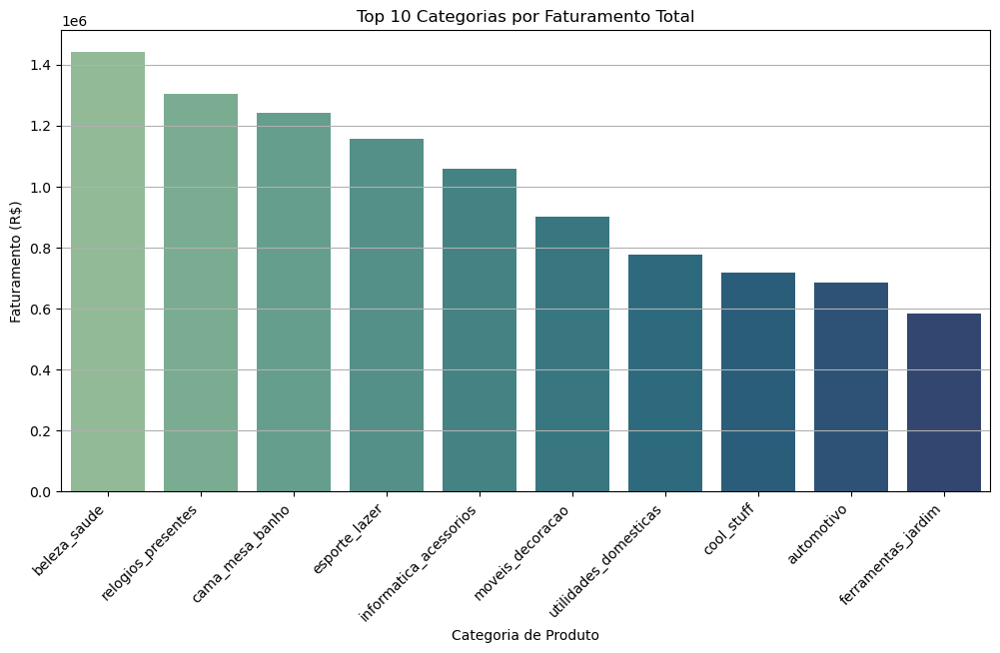

In [14]:
# Consulta SQL: top 10 categorias de produtos com maior faturamento
query_categorias = ''' 
SELECT
    p.product_category_name AS categoria,
    SUM(oi.price + oi.freight_value) AS faturamento_total,
    COUNT(oi.order_id) AS quantidade_vendida
FROM order_items oi
JOIN products p ON oi.product_id = p.product_id
GROUP BY p.product_category_name
ORDER BY faturamento_total DESC
LIMIT 10
'''

df_categorias = pd.read_sql(query_categorias, conn)

# Visualização
plt.figure(figsize=(12,6))
sns.barplot(data=df_categorias, x='categoria', y='faturamento_total', hue='categoria', palette='crest', legend=False)
plt.title('Top 10 Categorias por Faturamento Total')
plt.ylabel('Faturamento (R$)')
plt.xlabel('Categoria de Produto')
plt.xticks(rotation=45, ha='right')
plt.grid(axis='y')
plt.show()

#### Análise D: Insight

As categorias com maior faturamento são Beleza e sáude, Presentes e Cama, mesa e banho. Esses segmentos concentram alto volume de vendas e ticket médio elevado, sendo estratégico para ações de marketing, promoções e ampliação do catálogo visando maior retorno financeiro. 

### e) Quais estados brasileiros possuem o maior valor médio de pedidos?

C:\Users\Gustavo\AppData\Local\Temp\ipykernel_14780\1663874065.py:20: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=df_estados, x='estado', y='valor_medio_pedido', palette='viridis')


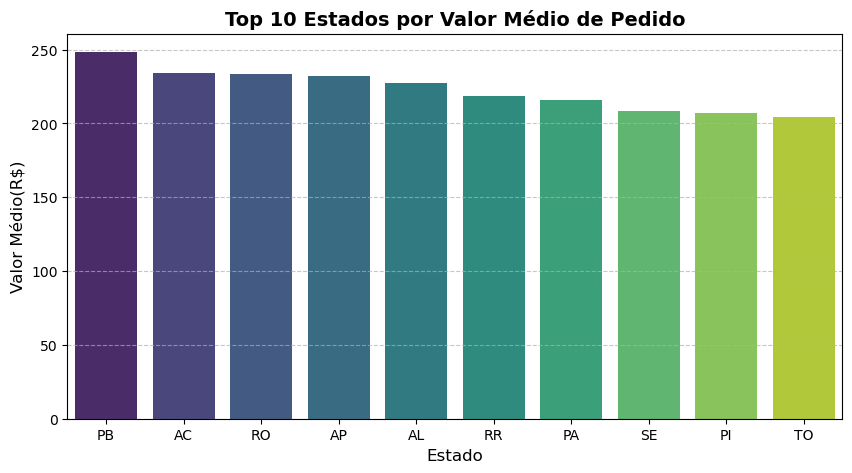

In [15]:
# Consulta SQL para obter o valor médio de pedido e o total por estado
query_estados = """
SELECT 
    c.customer_state AS estado,                        
    AVG(op.payment_value) AS valor_medio_pedido,         
    COUNT(DISTINCT o.order_id) AS total_pedidos          
FROM orders o
JOIN customers c ON o.customer_id = c.customer_id        
JOIN order_payments op ON o.order_id = op.order_id       
GROUP BY c.customer_state                                
ORDER BY valor_medio_pedido DESC                         
LIMIT 10                                                 
"""

# Executa a consulta e armazena em um dataframe
df_estados = pd.read_sql(query_estados, conn)

# Criação do gráfico de barras 
plt.figure(figsize=(10, 5))
sns.barplot(data=df_estados, x='estado', y='valor_medio_pedido', palette='viridis')
plt.title('Top 10 Estados por Valor Médio de Pedido', fontsize=14, fontweight='bold')
plt.xlabel('Estado', fontsize=12)
plt.ylabel('Valor Médio(R$)', fontsize=12)
plt.xticks(rotation=0)
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()


### Análise E: Insight

Estados como Paraíba (PB), Acre(AC) e Rondônia (RO) apresentam os maiores valores médios por pedido, indicando consumidores com maior propensão a compras de alto valor. Investir em ações de fidelização, campanhas segmentadas e ajustes logísticos são as melhores estretégias para ampliar o ticket médio e rentabilidade por cliente. 

## 3. Solução de Problemas de Negócio 

### Análise de Retenção

In [16]:
# Junção das tabelas de pedidos e clientes
clientes_pedidos= pd.merge(orders, customers, on='customer_id')

# Contagem de pedidos únicos por cliente
pedidos_por_cliente = clientes_pedidos.groupby('customer_unique_id')['order_id'].nunique()

# Filtra clientes recorrentes (mais de 1 pedido)
clientes_recorrentes = pedidos_por_cliente[pedidos_por_cliente > 1]

# Calcula a taxa de clintes recorrentes
taxa_retencao = len(clientes_recorrentes) / len(pedidos_por_cliente)

# Resultado
print(f' Taxa de clientes recorrentes: {taxa_retencao:.2%}')

 Taxa de clientes recorrentes: 3.12%


#### Insight: 

A taxa de clientes recorrentes é de apenas 3,12%, indicando que a grande maioria dos consumidores realiza apenas uma compra. Esse baixo índice de fidelização, torna o crescimento do negócio excessivamente dependente da aquisição constante de novos clientes. Esse cenário revela uma oportunidade clara na adoção de estratégias de retenção, programas de fidelidade, remarketing e ações pós-venda, estratégias que estimulam a recompra e aumentam o valor do ciclo de vida do cliente.

### Predição de Atraso

In [17]:
# Carrega os dados
orders = pd.read_csv('olist_orders_dataset.csv', parse_dates=['order_purchase_timestamp', 'order_delivered_customer_date', 'order_estimated_delivery_date'])

# Define o pedido atrasado
orders['atrasado'] = (orders['order_delivered_customer_date'] > orders['order_estimated_delivery_date']).astype(int)

# Cria features
orders['dias_estimados'] = (orders['order_estimated_delivery_date'] - orders['order_purchase_timestamp']).dt.days
orders = orders.dropna(subset=['order_delivered_customer_date', 'order_estimated_delivery_date'])
orders['mes_compra'] = orders['order_purchase_timestamp'].dt.month
orders['dia_semana_compra'] = orders['order_purchase_timestamp'].dt.dayofweek

# Seleciona variáveis 
features = ['dias_estimados', 'mes_compra', 'dia_semana_compra']
x = orders[features]
y = orders['atrasado']

# Separa em treino e teste
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

# Treina o modelo
from sklearn.ensemble import RandomForestClassifier
model = RandomForestClassifier(n_estimators=100, random_state=42, n_jobs=-1)
model.fit(x_train, y_train)

# Avalia o modelo
from sklearn.metrics import classification_report, confusion_matrix
y_pred = model.predict(x_test)

# Relatório de classificação
print('Relatório de Classificação:')
print(classification_report(y_test, y_pred))

# Importância das variáveis
importancias = pd.DataFrame({
    'feature': features,
    'importancia': model.feature_importances_
}).sort_values('importancia', ascending=False)

print('Importância das Features:')
print(importancias)

# Matriz de confusão
import plotly.express as px
cm = confusion_matrix(y_test, y_pred)
fig_cm = px.imshow(
    cm,
    labels=dict(x='Previsto', y='Real', color='Contagem'),
    x=['Não Atrasado', 'Atrasado'],
    y=['Não Atrasado', 'Atrasado'],
    title='Matriz de Confusão - Predição de Atraso',
    text_auto=True
)
fig_cm.show()


Relatório de Classificação:
              precision    recall  f1-score   support

           0       0.92      1.00      0.96     17735
           1       0.30      0.01      0.01      1561

    accuracy                           0.92     19296
   macro avg       0.61      0.50      0.49     19296
weighted avg       0.87      0.92      0.88     19296

Importância das Features:
             feature  importancia
0     dias_estimados     0.572900
1         mes_compra     0.353759
2  dia_semana_compra     0.073341


#### Análise: Insight 

Esse modelo ajuda a empresa a identificar antecipadamente pedidos com alto risco de atraso, possibilitando ações preventivas, como ajustar a logística ou comunicar o cliente com antecedência. Isso contribui para a melhora da experiência do consumidor, reduz feedbacks negativos e torna o processo mais eficiente.

### Segmentação de Clientes 

In [18]:
# Cria features para o clustering 
query_features_clientes = """
SELECT
    c.customer_id,
    COUNT(o.order_id) AS num_pedidos,
    AVG(op.payment_value) AS valor_medio_pedido,
    MAX(o.order_purchase_timestamp) AS data_ultimo_pedido
FROM customers c
JOIN orders o ON c.customer_id = o.customer_id
JOIN order_payments op ON o.order_id = op.order_id
GROUP BY c.customer_id
"""

df_features_clientes = pd.read_sql(query_features_clientes, conn)
df_features_clientes['data_ultimo_pedido'] = pd.to_datetime(df_features_clientes['data_ultimo_pedido'])

# Cria variável de recência 
data_referencia = pd.Timestamp('2018-09-01')
df_features_clientes['recencia_dias'] = (data_referencia - df_features_clientes['data_ultimo_pedido']).dt.days

# Seleciona variáveis para o clustering 
x_cluster = df_features_clientes[['num_pedidos', 'valor_medio_pedido', 'recencia_dias']]

# Normaliza os dados
scaler = StandardScaler()
x_scaled = scaler.fit_transform(x_cluster)

# Define o número ideal de clusters
inertia = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
    kmeans.fit(x_scaled)
    inertia.append(kmeans.inertia_)

# Gráfico do método do cotovelo
fig_elbow = px.line(x=list(range(1, 11)), y=inertia,
                    title='Método do Cotovelo - Número de Clusters',
                    labels={'x': 'Número de Clusters', 'y': 'Inércia'})
fig_elbow.show()

# Aplica K-Means com número ideal de clusters 
kmeans = KMeans(n_clusters=4, random_state=42, n_init=10)
df_features_clientes['cluster'] = kmeans.fit_predict(x_scaled)

# Analisa a média de comportamento por cluster
analise_cluster = df_features_clientes.groupby('cluster').agg({
    'num_pedidos': 'mean',
    'valor_medio_pedido': 'mean',
    'recencia_dias': 'mean',
    'customer_id': 'count'
}).rename(columns={'customer_id': 'num_clientes'})

print('\nAnálise dos clusters de clientes:')
print(analise_cluster)

# Visualização do clusters em 3D
fig_clusters = px.scatter_3d(df_features_clientes, x='num_pedidos', y='valor_medio_pedido', z='recencia_dias',
                             color='cluster', opacity=0.7,
                             title='Segmentação de Clientes - Clustering K-Means',
                             labels={'num_pedidos': 'Nº de Pedidos',
                                     'valor_medio_pedido': 'Valor Médio (R$)',
                                     'recencia_dias': 'Recência (dias)'})
fig_clusters.show()


Análise dos clusters de clientes:
         num_pedidos  valor_medio_pedido  recencia_dias  num_clientes
cluster                                                              
0           1.035576          128.899068     392.750653         40955
1           1.027047          131.085188     132.077209         55201
2           1.011311         1071.522310     244.715236          3006
3           6.258993           25.333300     284.464029           278


####  Análise: Insight 

Cada **cluster representa um grupo de clientes com comportamentos de compra semelhantes**, com base no número de pedidos, valor médio e recência.

**Aplicações práticas:**

- Criar **campanhas específicas** para clientes de **alto valor**.
- Aplicar **incentivos para aumentar a frequência** de compra em clientes com menor volume.
- **Reengajar clientes inativos**, com ações baseadas na recência de compras.

#### Análise de Satisfação do Cliente

In [21]:
# Consulta SQL: Análise da satisfação do cliente com base na entrega, atraso e valor
query_satisfacao = """
SELECT
    r.review_score,
    julianday(o.order_delivered_customer_date) - julianday(o.order_purchase_timestamp) as tempo_entrega_dias,
    julianday(o.order_delivered_customer_date) - julianday(o.order_estimated_delivery_date) as atraso_dias,
    op.payment_value as valor_pedido,
    p.product_category_name as categoria
FROM order_reviews r
JOIN orders o ON r.order_id = o.order_id
JOIN order_payments op ON o.order_id = op.order_id
JOIN order_items oi ON o.order_id = oi.order_id
JOIN Products p on oi.product_id = p.product_id
WHERE o.order_delivered_customer_date IS NOT NULL
"""

# Executa a query
df_satisfacao = pd.read_sql(query_satisfacao, conn)

# Remove outliers extremos para melhor visualização 
df_satisfacao = df_satisfacao[df_satisfacao['tempo_entrega_dias'] < 100]
df_satisfacao = df_satisfacao[df_satisfacao['valor_pedido'] < 3000]

# Gráfico: Relação entre tempo de entrega e avaliação
fig_tempo_satisfacao = px.box(
    df_satisfacao,
    x='review_score',
    y='tempo_entrega_dias',
    title='Relação entre Tempo de Entrega e Satisfação do Cliente',
    labels={
        'review_score': 'Avaliação (1-5)',
        'tempo_entrega_dias': 'Tempo de Entrega(dias)'
    }
)
fig_tempo_satisfacao.show()

# Gráfico: Relação entre Atraso e Avaliação
df_satisfacao['atraso_real'] = df_satisfacao['atraso_dias'] > 0
fig_atraso_satisfacao = px.box(
    df_satisfacao,
    x='atraso_real',
    y='review_score',
    title='Impacto do Atraso na Satisfação do Cliente',
    labels={
        'atraso_real': 'Pedido Atrasado',
        'review_score': 'Avaliação (1-5)'
    },
    color='atraso_real'
)
fig_atraso_satisfacao.show()

# Avaliação média por categoria
avaliacoes_por_categoria = df_satisfacao.groupby('categoria')['review_score'] \
        .agg(['mean', 'count']) \
        .sort_values('mean', ascending=False) \
        .reset_index()
avaliacoes_por_categoria = avaliacoes_por_categoria[avaliacoes_por_categoria['count'] > 30]

# Gráfico: Top 15 categorias com melhores avaliações
fig_categorias_satisfacao = px.bar(
    avaliacoes_por_categoria.head(15),
    x='categoria',
    y='mean',
    title='Top 15 Categorias com Melhor Avaliação',
    labels={
        'categoria': 'Categoria',
        'mean': 'Avaliação Média (1-5)'
    },
    hover_data = ['count']
)
fig_categorias_satisfacao.update_layout(template='plotly_white')
fig_categorias_satisfacao.show()

#### Análise: Insight
Categorias com avaliações baixas indicam possíveis problemas de qualidade ou falha em atender expectativas dos clientes. Além disso, entregas demoradas estão associadas a avaliações menores, mostrando que atrasos na logística afetam negativamente a satisfação do cliente.

#### Visualização

In [20]:
# Consulta SQL: Total de vendas por mês 
query_vendas_tempo = """
SELECT 
    strftime('%Y-%m', o.order_purchase_timestamp) AS mes,
    COUNT(o.order_id) AS num_pedidos,
    SUM(op.payment_value) AS valor_total
FROM orders o
JOIN order_payments op ON o.order_id = op.order_id 
GROUP BY mes
ORDER BY mes
"""

# Executa e converte a coluna 'mes' para formato de data
df_vendas_tempo = pd.read_sql(query_vendas_tempo, conn)
df_vendas_tempo['mes'] = pd.to_datetime(df_vendas_tempo['mes'] + '-01')

# Gráfico: Evolução de vendas mensal 
fig_evolucao = go.Figure()

# Valor total de vendas
fig_evolucao.add_trace(go.Scatter(
    x=df_vendas_tempo['mes'],
    y=df_vendas_tempo['valor_total'],
    mode='lines+markers',
    name='Valor Total (R$)',
    line=dict(color='blue')
))

# Número de pedidos
fig_evolucao.add_trace(go.Scatter(
    x=df_vendas_tempo['mes'],
    y=df_vendas_tempo['num_pedidos'],
    mode='lines+markers',
    name='Número de Pedidos',
    line=dict(color='red'),
    yaxis='y2'
))

# Layout
fig_evolucao.update_layout(
    title='Evolução das Vendas ao Longo do Tempo',
    xaxis_title='Mês',
    yaxis_title='Valor Total (R$)',
    yaxis2=dict(
        title='Número de Pedidos',
        overlaying='y',
        side='right'
    ),
    template='plotly_white',
    height=500
)

fig_evolucao.show()

In [ ]:
# Mapa de Calor - Vendas Por Estado
# Consulta SQL:
query_vendas_estado = """
SELECT
    c.customer_state AS estado,
    COUNT(o.order_id) AS total_pedidos
FROM customers c
JOIN orders o ON c.customer_id = o.customer_id
GROUP BY c.customer_state
ORDER BY total_pedidos DESC
"""

# Dataframe e padronização de siglas
df_vendas_estado =pd.read_sql(query_vendas_estado, conn)
df_vendas_estado['estado'] = df_vendas_estado['estado'].str.upper()

# Carregando GeoJSON dos estados do Brasil
url_geojson = 'https://raw.githubusercontent.com/codeforamerica/click_that_hood/master/public/data/brazil-states.geojson'
geojson_brasil = requests.get(url_geojson).json()

# Dicionário de conversão
sigla_para_nome = {
    'AC': 'Acre', 'AL': 'Alagoas', 'AP': 'Amapá', 'AM': 'Amazonas',
    'BA': 'Bahia', 'CE': 'Ceará', 'DF': 'Distrito Federal', 'ES': 'Espírito Santo',
    'GO': 'Goiás', 'MA': 'Maranhão', 'MT': 'Mato Grosso', 'MS': 'Mato Grosso do Sul',
    'MG': 'Minas Gerais', 'PA': 'Pará', 'PB': 'Paraíba', 'PR': 'Paraná',
    'PE': 'Pernambuco', 'PI': 'Piauí', 'RJ': 'Rio de Janeiro', 'RN': 'Rio Grande do Norte',
    'RS': 'Rio Grande do Sul', 'RO': 'Rondônia', 'RR': 'Roraima', 'SC': 'Santa Catarina',
    'SP': 'São Paulo', 'SE': 'Sergipe', 'TO': 'Tocantins'
}

# Mapeia a sigla da UF para o nome completo
df_vendas_estado['estado_nome'] = df_vendas_estado['estado'].map(sigla_para_nome)

# Gráfico:
fig = px.choropleth(
    df_vendas_estado,
    geojson=geojson_brasil,
    locations='estado_nome',
    featureidkey='properties.name',
    color='total_pedidos',
    color_continuous_scale='Blues',
    labels={'total_pedidos': 'Total de Pedidos'},
    title='Concetração de Vendas por Estado - Brasil'
)

# Ajuste visual para centralizar o Brasil
fig.update_geos(fitbounds="locations", visible=False)

# Exibir mapa
fig.show()

In [ ]:
# Consulta SQL: Avaliação do Cliente vs Tempo de Entrega
query_avaliacao_entrega = """
SELECT
    o.order_id,
    order_approved_at,
    o.order_delivered_customer_date,
    r.review_score
FROM orders o
JOIN order_reviews r ON o.order_id = r.order_id
WHERE o.order_delivered_customer_date IS NOT NULL
"""

# Executa e carrega os dados no dataframe
df = pd.read_sql(query_avaliacao_entrega, conn)

# Converte colunas de data para datetime
df['order_approved_at'] = pd.to_datetime(df['order_approved_at'])
df['order_delivered_customer_date'] = pd.to_datetime(df['order_delivered_customer_date'])

# Calcula o tempo de entrega em dias
df['tempo_entrega_dias'] = (df['order_delivered_customer_date'] - df['order_approved_at']).dt.days

# Gráfico:
fig_scatter = px.scatter(
    df,
    x='tempo_entrega_dias',
    y='review_score',
    title='Tempo de Entrega vs Avaliação do Cliente',
    labels={
        'tempo_entrega_dias': 'Tempo de Entrega (dias)',
        'review_score': 'Avaliação do Cliente'
    },
    opacity=0.5
)

fig_scatter.show()


# Agrupa por nota e média do tempo de entrega
df_media_tempo = (
    df.groupby('review_score')['tempo_entrega_dias']
    .mean()
    .reset_index()
)

# Gráfico: 
fig_bar = px.bar(
    df_media_tempo,
    x='review_score',
    y='tempo_entrega_dias',
    title='Tempo Médio de Entrega por Avaliação',
    labels={
        'review_score': 'Avaliação do Cliente',
        'tempo_entrega_dias': 'Tempo Médio de Entrega (dias)'
    }
)

fig_bar.show()

In [ ]:
# Consulta SQL: Análise dos Vendedores 
query_vendedores = """
SELECT
    oi.seller_id,
    o.order_id,
    o.order_purchase_timestamp,
    o.order_delivered_customer_date,
    r.review_score
FROM order_items oi
JOIN orders o on oi.order_id = o.order_id
JOIN order_reviews r ON o.order_id = r.order_id
WHERE o.order_delivered_customer_date IS NOT NULL
"""

# Carrega dados 
df_vendedores = pd.read_sql(query_vendedores, conn)

# Convertendo colunas de data
df_vendedores['order_purchase_timestamp'] = pd.to_datetime(df_vendedores['order_purchase_timestamp'])
df_vendedores['order_delivered_customer_date'] = pd.to_datetime(df_vendedores['order_delivered_customer_date'])

# Calcula tempo de entrega (dias)
df_vendedores['tempo_entrega_dias'] = (
    df_vendedores['order_delivered_customer_date'] - df_vendedores['order_purchase_timestamp']
).dt.days

# Agrupa e calcula métricas
df_analise = (
    df_vendedores
    .groupby('seller_id')
    .agg(
        volume_vendas=('order_id', 'count'),
        satisfacao_media=('review_score', 'mean'),
        tempo_medio_entrega=('tempo_entrega_dias', 'mean')
    )
    .reset_index()
)

# Ordena por volume de vendas
df_analise = df_analise.sort_values(by='volume_vendas', ascending=False).reset_index(drop=True)

# Gera rótulos "Vendedor 1", "Vendedor 2", ...
df_analise['ranking'] = df_analise.index + 1
df_analise['vendor_label'] = 'Vendedor ' + df_analise['ranking'].astype(str)

# Seliciona o Top 10
df_top10 = df_analise.head(10)

# Gráfico: Volume de Vendas
fig_volume = px.bar(
    df_top10,
    x='vendor_label',
    y='volume_vendas',
    title='Top 10 Vendedores por Volume de Vendas',
    labels={'Vendor_label': 'Vendedor', 'volume_vendas': 'Número de Pedidos'}
)
fig_volume.update_layout(xaxis_tickangle=-45)
fig_volume.show()

# Gráfico: Satisfação Média
fig_satisfacao = px.bar(
    df_top10,
    x='vendor_label',
    y='satisfacao_media',
    title='Top 10 Vendedores por Satisfação do Cliente',
    labels={'vendor_label': 'vendedor', 'satisfcao_media': 'Avaliação Média'}
)

fig_satisfacao.update_layout(xaxis_tickangle=-45)
fig_satisfacao.show()

# Gráfico: Tempo Médio de Entrega
fig_tempo = px.bar(
    df_top10, 
    x='vendor_label',
    y='tempo_medio_entrega',
    title='Top 10 Vendedores por Tempo Médio de Entrega',
    labels={'vendor_label': 'Vendedor', 'tempo_medio_entrega': 'Tempo Médio de Entrega (dias)'}
)
fig_tempo.update_layout(xaxis_tickangle=-45)
fig_tempo.show()

